In [150]:
# Data manipulation and analysis
import dask.dataframe as dd
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
from folium import plugins
from branca.colormap import LinearColormap
from branca.element import Figure

# Interactive widgets and display
import ipywidgets as widgets
from IPython.display import display, HTML, clear_output

# Panel for dashboards
import panel as pn
pn.extension('plotly')

# System utilities
import multiprocessing as mp
import requests
import json
import time
from datetime import datetime, timedelta
from functools import lru_cache
import colorsys

In [ ]:
# Load the timeseries data
clean_22 = pd.read_pickle('../data_raw/df_filled_22.pkl')
clean_23 = pd.read_pickle('../data_raw/df_filled_23.pkl')
clean_22.head()

timestamp,2022-02-01 00:00:00,2022-02-01 01:00:00,2022-02-01 02:00:00,2022-02-01 03:00:00,2022-02-01 04:00:00,2022-02-01 05:00:00,2022-02-01 06:00:00,2022-02-01 07:00:00,2022-02-01 08:00:00,2022-02-01 09:00:00,...,2022-12-31 14:00:00,2022-12-31 15:00:00,2022-12-31 16:00:00,2022-12-31 17:00:00,2022-12-31 18:00:00,2022-12-31 19:00:00,2022-12-31 20:00:00,2022-12-31 21:00:00,2022-12-31 22:00:00,2022-12-31 23:00:00
station_complex_id,,,,,,,,,,,,,,,,,,,,,
1,17.0,5.0,6.0,12.0,44.0,143.0,405.0,735.0,950.0,512.0,...,426.0,402.0,304.0,338.0,322.0,350.0,309.0,293.0,168.0,75.0
10,100.0,24.0,7.0,8.0,8.0,14.0,43.0,98.0,175.0,182.0,...,3.0,4.0,4.0,4.0,3.0,4.0,5.0,8.0,5.0,2.0
100,10.0,3.0,0.0,3.0,5.0,17.0,46.0,68.0,106.0,66.0,...,68.0,69.0,69.0,55.0,58.0,61.0,67.0,52.0,56.0,25.0
101,26.0,10.0,9.0,3.0,20.0,49.0,124.0,245.0,394.0,247.0,...,286.0,316.0,332.0,269.0,239.0,246.0,239.0,209.0,179.0,104.0
118,21.0,11.0,9.0,3.0,1.0,9.0,14.0,61.0,75.0,54.0,...,249.0,279.0,245.0,245.0,287.0,273.0,278.0,281.0,245.0,115.0


In [132]:
# Load the station data
station_df = pd.read_csv(r'D:\capstone_F24\data/Cleaned_data/station_data.csv')
station_df.head()

,station_complex_id,station_complex,borough,latitude,longitude,nearby_attractions
0,1,"Astoria-Ditmars Blvd (N,W)",Queens,40.775036,-73.91203,"Astoria Internet Cafe, Silver Age Comics, Spa ..."
1,2,"Astoria Blvd (N,W)",Queens,40.770260,-73.91785,"Bana Spa, Deja Vu New York, Omorphia Spa NYC, ..."
2,3,"30 Av (N,W)",Queens,40.766780,-73.92148,"DD, Diamondy Doux: Stephen, Art For After Hour..."
3,4,"Broadway (N,W)",Queens,40.761820,-73.92551,"Break Bar and Billiards, Diamond Works Medspa,..."
4,5,"36 Av (N,W)",Queens,40.756805,-73.92957,"Tantra Lounge, Bld Spa New York, Snowdonia, cu..."


In [133]:
station_df

,station_complex_id,station_complex,borough,latitude,longitude,nearby_attractions
0,1,"Astoria-Ditmars Blvd (N,W)",Queens,40.775036,-73.912030,"Astoria Internet Cafe, Silver Age Comics, Spa ..."
1,2,"Astoria Blvd (N,W)",Queens,40.770260,-73.917850,"Bana Spa, Deja Vu New York, Omorphia Spa NYC, ..."
2,3,"30 Av (N,W)",Queens,40.766780,-73.921480,"DD, Diamondy Doux: Stephen, Art For After Hour..."
3,4,"Broadway (N,W)",Queens,40.761820,-73.925510,"Break Bar and Billiards, Diamond Works Medspa,..."
4,5,"36 Av (N,W)",Queens,40.756805,-73.929570,"Tantra Lounge, Bld Spa New York, Snowdonia, cu..."
...,...,...,...,...,...,...
849,97,"Myrtle Av (M,J,Z)",Brooklyn,40.697210,-73.935650,"Skyscrapers and Stories, NYC Scalp Studio, Caf..."
850,98,"Flushing Av (M,J)",Brooklyn,40.700260,-73.941124,"Fat Albert, Gallery54, Garden Playground, V.i...."
851,99,"Lorimer St (M,J)",Brooklyn,40.703870,-73.947410,"Exprink, Shoppers World, Canal Jeans, E. V. Ha..."
852,TRAM1,RI Tramway (Manhattan),Manhattan,40.761337,-73.964160,"The Roosevelt Island Tramway, Eileen Lane Anti..."


## Interactive timeseries with year and station selector

In [151]:
def create_interactive_timeseries_dashboard(df_2022, df_2023, station_info=None):
    """
    Create an interactive timeseries dashboard that can be exported to HTML
    Parameters:
    - df_2022, df_2023: DataFrames with ridership data
    - station_info: DataFrame with columns: station_complex_id, station_complex, borough, latitude, longitude, nearby_attractions
    """
    window_labels = {
        'Daily': 24,
        'Weekly': 168,
        'Monthly': 720,
        'Quarterly': 2160
    }
    
    # Pre-process station information
    if station_info is not None and not station_info.empty:
        station_mapping = {
            row['station_complex_id']: {
                'name': row['station_complex'],
                'borough': row['borough'],
                'poi': (row['nearby_attractions'].split(', ') 
                       if isinstance(row['nearby_attractions'], str) and pd.notna(row['nearby_attractions'])
                       else [])
            }
            for _, row in station_info.iterrows()
        }
        station_options = sorted([
            (f"{info['name']} (Station {station_id})", station_id)
            for station_id, info in station_mapping.items()
            if station_id in df_2022.index
        ], key=lambda x: x[0])
    else:
        station_mapping = {}
        station_options = sorted([
            (str(idx), idx) for idx in df_2022.index
        ], key=lambda x: x[0])

    # Create panes with parameters that can be bound
    station = pn.widgets.Select(
        name='Station',
        options=dict(station_options),
        value=station_options[0][1],
        width=400
    )
    
    window = pn.widgets.Select(
        name='Moving Average Window',
        options=list(window_labels.keys()),
        value='Weekly',
        width=200
    )

    @pn.depends(station.param.value, window.param.value)
    def plot_timeseries(station_val, window_val):
        window_size = window_labels[window_val]
        
        # Get station details
        station_details = ""
        if station_info is not None and not station_info.empty and station_val in station_mapping:
            info = station_mapping[station_val]
            details = []
            if 'borough' in info:
                details.append(f"Borough: {info['borough']}")
            if 'poi' in info and info['poi']:
                poi_list = info['poi'][:5]  # Show first 5 attractions
                details.append(f"Nearby: {', '.join(poi_list)}")
            station_details = '<br>'.join(details)

        fig = make_subplots(
            rows=2, cols=1,
            row_heights=[0.6, 0.4],
            subplot_titles=('Ridership Trends', 'Average Daily Pattern'),
            vertical_spacing=0.22
        )

        # Process 2022 data
        data_22 = pd.DataFrame(df_2022.loc[station_val]).reset_index()
        data_22.columns = ['timestamp', 'ridership']
        data_22['timestamp'] = pd.to_datetime(data_22['timestamp'])
        data_22['moving_avg'] = data_22['ridership'].rolling(
            window=window_size, center=True, min_periods=1).mean()
        daily_pattern_22 = data_22.groupby(
            data_22['timestamp'].dt.hour)['ridership'].mean()

        # Process 2023 data
        data_23 = pd.DataFrame(df_2023.loc[station_val]).reset_index()
        data_23.columns = ['timestamp', 'ridership']
        data_23['timestamp'] = pd.to_datetime(data_23['timestamp'])
        data_23['moving_avg'] = data_23['ridership'].rolling(
            window=window_size, center=True, min_periods=1).mean()
        daily_pattern_23 = data_23.groupby(
            data_23['timestamp'].dt.hour)['ridership'].mean()

        # Add traces with hover text
        fig.add_trace(go.Scatter(
            x=data_22['timestamp'], 
            y=data_22['ridership'],
            name='2022 Raw', 
            opacity=0.4, 
            line=dict(color='#B933AD'),
            hovertemplate='Date: %{x|%Y-%m-%d %H:%M}<br>Riders: %{y:,.0f}<br>Type: Raw Data<extra></extra>'
        ), row=1, col=1)
        
        fig.add_trace(go.Scatter(
            x=data_22['timestamp'], 
            y=data_22['moving_avg'],
            name=f'2022 {window_val} MA',
            line=dict(color='#B933AD', width=2),
            hovertemplate='Date: %{x|%Y-%m-%d %H:%M}<br>Riders: %{y:,.0f}<br>Type: Moving Average<extra></extra>'
        ), row=1, col=1)
        
        fig.add_trace(go.Scatter(
            x=daily_pattern_22.index, 
            y=daily_pattern_22.values,
            name='2022 Daily Pattern', 
            line=dict(color='#B933AD', width=2),
            showlegend=False,
            hovertemplate='Hour: %{x}:00<br>Average Riders: %{y:,.0f}<extra></extra>'
        ), row=2, col=1)
            
        fig.add_trace(go.Scatter(
            x=data_23['timestamp'], 
            y=data_23['ridership'],
            name='2023 Raw', 
            opacity=0.4, 
            line=dict(color='#6CBE45'),
            hovertemplate='Date: %{x|%Y-%m-%d %H:%M}<br>Riders: %{y:,.0f}<br>Type: Raw Data<extra></extra>'
        ), row=1, col=1)
        
        fig.add_trace(go.Scatter(
            x=data_23['timestamp'], 
            y=data_23['moving_avg'],
            name=f'2023 {window_val} MA',
            line=dict(color='#6CBE45', width=2),
            hovertemplate='Date: %{x|%Y-%m-%d %H:%M}<br>Riders: %{y:,.0f}<br>Type: Moving Average<extra></extra>'
        ), row=1, col=1)
        
        fig.add_trace(go.Scatter(
            x=daily_pattern_23.index, 
            y=daily_pattern_23.values,
            name='2023 Daily Pattern', 
            line=dict(color='#6CBE45', width=2),
            showlegend=False,
            hovertemplate='Hour: %{x}:00<br>Average Riders: %{y:,.0f}<extra></extra>'
        ), row=2, col=1)

        # Update layout
        station_name = (f"Station {station_val}" if station_info is None or station_info.empty or station_val not in station_mapping 
                       else f"Station {station_val} - {station_mapping[station_val]['name']}")
        title_text = f'Ridership Analysis for {station_name}' + (
            f"<br><sup>{station_details}</sup>" if station_details else "")

        fig.update_layout(
            title={'text': title_text, 'x': 0.5, 'xanchor': 'center',
                  'y': 0.95, 'yanchor': 'top'},
            height=800,
            width=1200,
            showlegend=True,
            legend=dict(yanchor="top", y=1.02, xanchor="left", x=0.01),
            margin=dict(l=50, r=50, t=120, b=80),
            template="plotly_white",
            hoverlabel=dict(
                bgcolor="white",
                font_size=14,
                bordercolor="black"
            )
        )
        
        fig.update_xaxes(title_text="Date", row=1, col=1)
        fig.update_xaxes(title_text="Hour of Day", dtick=2, row=2, col=1)
        fig.update_yaxes(title_text="Ridership", row=1, col=1)
        fig.update_yaxes(title_text="Average Ridership", row=2, col=1)
        fig.update_xaxes(rangeslider_visible=True, row=1, col=1,
                        rangeslider=dict(thickness=0.05))
        
        return fig

    # Create the dashboard
    dashboard = pn.Column(
        pn.Row(station, window),
        plot_timeseries,
        sizing_mode='stretch_width'
    )
    
    # Save to HTML
    dashboard.save('interactive_dashboard.html', embed=True)
    
    return dashboard

In [138]:
dashboard = create_interactive_timeseries_dashboard(clean_22, clean_23, station_df)
dashboard.servable()

Column(sizing_mode='stretch_width')
    [0] Row
        [0] Select(name='Station', options={'1 Av (L) (Station 119)':...}, value='119', width=400)
        [1] Select(name='Moving Average Window', options=['Daily', 'Weekly', ...], value='Weekly', width=200)
    [1] ParamFunction(function, _pane=Plotly, defer_load=False)

## Transit planning map

In [152]:
def create_planning_map(df_2022, df_2023=None, station_info=None, month_year='2022-02'):
    """Create an interactive map optimized for transit planning insights."""
    
    # Define MTA colors for each borough
    BOROUGH_COLORS = {
        'Manhattan': '#FF6319',  # Orange (B/D/F/M)
        'Brooklyn': '#00933C',   # Green (4/5/6)
        'Queens': '#B933AD',     # Purple (7)
        'Bronx': '#EE352E',      # Red (1/2/3)
        'Staten Island': '#00ADD0'  # Light Blue (SIR)
    }
    
    def adjust_color_brightness(hex_color, ratio):
        """Adjust color brightness based on peak/off-peak ratio"""
        hex_color = hex_color.lstrip('#')
        rgb = tuple(int(hex_color[i:i+2], 16) for i in (0, 2, 4))
        h, l, s = colorsys.rgb_to_hls(*[x/255.0 for x in rgb])
        l = max(0.2, min(0.8, 0.8 - (ratio * 0.4)))
        rgb = colorsys.hls_to_rgb(h, l, s)
        return '#%02x%02x%02x' % tuple(int(x * 255) for x in rgb)
    
    def calculate_station_metrics(data, month_year):
        """Calculate key metrics for each station"""
        metrics_dict = {}
        
        month_start = pd.to_datetime(month_year + '-01')
        month_end = pd.Timestamp(month_start) + pd.offsets.MonthEnd(1)
        mask = (data.columns >= month_start) & (data.columns <= month_end)
        month_data = data.loc[:, mask]
        
        if month_data.empty:
            print(f"No data found for {month_year}")
            return pd.DataFrame()
            
        print(f"Processing {len(month_data.index)} stations for {month_year}")
        
        for station_id in month_data.index:
            try:
                station_data = month_data.loc[station_id]
                station_data.index = pd.to_datetime(station_data.index)
                hourly_avg = station_data.groupby(station_data.index.hour).mean()
                
                if len(hourly_avg) < 12:
                    continue
                
                am_peak = hourly_avg[7:11].mean()
                pm_peak = hourly_avg[16:20].mean()
                off_peak_hours = list(range(0,7)) + list(range(11,16)) + list(range(20,24))
                off_peak = hourly_avg[hourly_avg.index.isin(off_peak_hours)].mean()
                
                if pd.isna(am_peak) or pd.isna(pm_peak) or pd.isna(off_peak) or off_peak == 0:
                    continue
                
                peak_ratio = (am_peak + pm_peak) / (2 * off_peak)
                daily_total = hourly_avg.mean() * 24
                
                metrics_dict[station_id] = {
                    'am_peak': am_peak,
                    'pm_peak': pm_peak,
                    'off_peak': off_peak,
                    'peak_ratio': peak_ratio,
                    'daily_total': daily_total
                }
            except Exception as e:
                print(f"Error processing station {station_id}: {str(e)}")
                continue
                
        if not metrics_dict:
            print("No valid stations found")
            return pd.DataFrame()
            
        return pd.DataFrame.from_dict(metrics_dict, orient='index')
    
    station_df = station_info
    
    # Get available months
    all_months = sorted([col.strftime('%Y-%m') for col in df_2022.columns])
    if df_2023 is not None:
        all_months.extend(sorted([col.strftime('%Y-%m') for col in df_2023.columns]))
    all_months = sorted(list(set(all_months)))
    
    # Create base map
    m = folium.Map(
        location=[40.7128, -74.0060],
        zoom_start=11,
        tiles='cartodbpositron'
    )

    # Add month groups
    for month in all_months:
        year = int(month[:4])
        metrics = calculate_station_metrics(df_2022 if year == 2022 else df_2023, month)
        
        if not metrics.empty:
            fg = folium.FeatureGroup(name=f"{month}")
            
            # Calculate YoY change for 2023
            yoy_change = None
            if df_2023 is not None and year == 2023:
                prev_year = f"{year-1}{month[4:]}"
                metrics_prev_year = calculate_station_metrics(df_2022, prev_year)
                if not metrics_prev_year.empty:
                    common_stations = metrics.index.intersection(metrics_prev_year.index)
                    if len(common_stations) > 0:
                        yoy_change = ((metrics.loc[common_stations, 'daily_total'] - 
                                     metrics_prev_year.loc[common_stations, 'daily_total']) / 
                                    metrics_prev_year.loc[common_stations, 'daily_total'] * 100)
            
            # Calculate normalized peak ratios for the whole dataset
            min_ratio = metrics['peak_ratio'].min()
            max_ratio = metrics['peak_ratio'].max()
            
            for station_id in metrics.index:
                try:
                    station_info_row = station_df[station_df['station_complex_id'] == station_id]
                    if station_info_row.empty:
                        continue
                        
                    station_metrics = metrics.loc[station_id]
                    borough = station_info_row['borough'].iloc[0]
                    
                    # Normalize peak ratio to 0-1 range
                    normalized_ratio = (station_metrics['peak_ratio'] - min_ratio) / (max_ratio - min_ratio)
                    
                    # Get borough color and adjust based on peak ratio
                    base_color = BOROUGH_COLORS[borough]
                    adjusted_color = adjust_color_brightness(base_color, normalized_ratio)
                    
                    radius = 5 + (station_metrics['daily_total'] - metrics['daily_total'].min()) / (
                        metrics['daily_total'].max() - metrics['daily_total'].min()) * 20
                    
                    popup_content = f"""
                        <div style='min-width: 200px'>
                        <b>{station_info_row['station_complex'].iloc[0]}</b><br>
                        <hr>
                        <b>Daily Average:</b> {int(station_metrics['daily_total']):,} riders<br>
                        <b>AM Peak (7-10):</b> {int(station_metrics['am_peak']):,} riders/hr<br>
                        <b>PM Peak (16-19):</b> {int(station_metrics['pm_peak']):,} riders/hr<br>
                        <b>Peak/Off-Peak Ratio:</b> {station_metrics['peak_ratio']:.2f}<br>
                        <b>Borough:</b> {borough}<br>
                    """
                    
                    if yoy_change is not None and station_id in yoy_change.index:
                        change = yoy_change[station_id]
                        if not pd.isna(change):
                            popup_content += f"<b>Year-over-Year Change:</b> {change:.1f}%<br>"
                    
                    # Add nearby attractions
                    attractions = station_info_row['nearby_attractions'].iloc[0]
                    if pd.notna(attractions):
                        attraction_list = attractions.split(', ')
                        if attraction_list:
                            popup_content += "<hr><b>Nearby Attractions:</b><br>"
                            popup_content += "<ul style='margin: 5px 0 5px 15px; padding: 0;'>"
                            for attraction in attraction_list[:5]:  # Show first 5 attractions
                                popup_content += f"<li>{attraction}</li>"
                            popup_content += "</ul>"
                    
                    popup_content += "</div>"
                    
                    folium.CircleMarker(
                        location=[float(station_info_row['latitude'].iloc[0]), 
                                 float(station_info_row['longitude'].iloc[0])],
                        radius=radius,
                        popup=popup_content,
                        color=adjusted_color,
                        fill=True,
                        fillColor=adjusted_color,
                        fillOpacity=0.7,
                    ).add_to(fg)
                    
                except Exception as e:
                    continue
            
            fg.add_to(m)
            if month != month_year:
                fg.hide = True

    # Add JavaScript for layer selection
    m.get_root().html.add_child(folium.Element("""
        <script>
        document.addEventListener('DOMContentLoaded', function() {
            // Get layer controls
            var layerControls = document.querySelectorAll('.leaflet-control-layers-overlays input[type="checkbox"]');
            
            // Set initial state - uncheck all except first
            layerControls.forEach(function(control, index) {
                if (index === 0) {
                    control.checked = true;
                } else {
                    control.checked = false;
                    // Trigger change event to ensure layer is hidden
                    var event = new Event('change');
                    control.dispatchEvent(event);
                }
            });
            
            // Add event listener to each control
            layerControls.forEach(function(control) {
                control.addEventListener('change', function(e) {
                    if (this.checked) {
                        // Uncheck all other layers
                        layerControls.forEach(function(other) {
                            if (other !== e.target && other.checked) {
                                other.checked = false;
                                // Trigger change event
                                var event = new Event('change');
                                other.dispatchEvent(event);
                            }
                        });
                    } else {
                        // If unchecking the only checked layer, prevent it
                        var anyChecked = false;
                        layerControls.forEach(function(other) {
                            if (other.checked) anyChecked = true;
                        });
                        if (!anyChecked) this.click();
                    }
                });
            });
        });
        </script>
    """))

    # Add title and legend
    title_html = f'''
    <div style="position: fixed; 
                top: 10px; 
                left: 50px; 
                width: 500px; 
                z-index:9999; 
                font-size:14px;
                background-color: white;
                padding: 15px;
                border-radius: 5px;
                border: 2px solid grey;">
        <h4>NYC Subway Station Analysis</h4>
        <ul style="list-style-type: none; padding-left: 0;">
            <li><b>Circle Size:</b> Average Daily Ridership</li>
            <li><b>Circle Color:</b> Borough with Peak/Off-Peak Ratio</li>
            <li style="margin-left: 20px"><small>Darker shades indicate higher peak/off-peak ratios</small></li>
            <li><b>Borough Colors:</b></li>
            {''.join([f'<li style="color: {color}">■ {borough}</li>' for borough, color in BOROUGH_COLORS.items()])}
        </ul>
        <p><small>Click stations for detailed metrics</small></p>
        <p><small>Select a month from the layers control in the top right</small></p>
    </div>
    '''
    m.get_root().html.add_child(folium.Element(title_html))

    # Add layer control
    folium.LayerControl(collapsed=False).add_to(m)
    
    return m

In [141]:
interactive_map = create_planning_map(clean_22, clean_23, station_df)
interactive_map.save('planning_map.html')
interactive_map

Processing 361 stations for 2022-02
Processing 361 stations for 2022-03
Processing 361 stations for 2022-04
Processing 361 stations for 2022-05
Processing 361 stations for 2022-06
Processing 361 stations for 2022-07
Processing 361 stations for 2022-08
Processing 361 stations for 2022-09
Processing 361 stations for 2022-10
Processing 361 stations for 2022-11
Processing 361 stations for 2022-12
Processing 361 stations for 2023-02
Processing 361 stations for 2022-02
Processing 361 stations for 2023-03
Processing 361 stations for 2022-03
Processing 361 stations for 2023-04
Processing 361 stations for 2022-04
Processing 361 stations for 2023-05
Processing 361 stations for 2022-05
Processing 361 stations for 2023-06
Processing 361 stations for 2022-06
Processing 361 stations for 2023-07
Processing 361 stations for 2022-07
Processing 361 stations for 2023-08
Processing 361 stations for 2022-08
Processing 361 stations for 2023-09
Processing 361 stations for 2022-09
Processing 361 stations for 

## Interactive heatmap with station and year selector

In [153]:
def classify_station_pattern(pattern_df, metrics):
    weekday_peak = pattern_df.iloc[:5, 7:10].mean().mean()
    weekend_peak = pattern_df.iloc[5:, :].mean().mean()
    evening_usage = pattern_df.iloc[:, 18:22].mean().mean()
    overnight = pattern_df.iloc[:, 1:4].mean().mean()
    
    weekday_weekend_ratio = metrics['weekday_avg'] / metrics['weekend_avg'] if metrics['weekend_avg'] > 0 else float('inf')
    peak_ratio = weekday_peak / overnight if overnight > 0 else float('inf')
    
    if weekday_weekend_ratio > 2.5 and peak_ratio > 5:
        pattern_type = "Commuter Station"
        characteristics = ["Strong weekday rush hour peaks", "Low weekend ridership"]
    elif weekday_weekend_ratio < 1.5 and evening_usage > 0.7 * weekday_peak:
        pattern_type = "Entertainment/Tourist Hub"
        characteristics = ["High weekend ridership", "Strong evening activity"]
    elif 1.5 <= weekday_weekend_ratio <= 2.5 and peak_ratio < 5:
        pattern_type = "Mixed-Use/Residential"
        characteristics = ["Moderate rush hour peaks", "Sustained daily activity"]
    else:
        pattern_type = "General Purpose"
        characteristics = ["Variable usage patterns", "No strong peak dominance"]
    
    return {
        'type': pattern_type,
        'characteristics': characteristics,
        'metrics': {
            'weekday_weekend_ratio': weekday_weekend_ratio,
            'peak_ratio': peak_ratio,
            'evening_usage_ratio': evening_usage / weekday_peak if weekday_peak > 0 else 0
        }
    }

def create_station_heatmap(df_2022, df_2023, station_info):
    """Create interactive heatmap showing ridership patterns"""
    
    # Create station mapping
    station_mapping = {
        row['station_complex_id']: {
            'name': row['station_complex'],
            'borough': row['borough'],
            'poi': (row['nearby_attractions'].split(', ') 
                   if pd.notna(row['nearby_attractions']) 
                   else [])
        }
        for _, row in station_info.iterrows()
    }
    
    # Create sorted station options
    station_options = [
        {'display_name': f"{info['name']} (Station {station_id})", 
         'station_id': station_id, 
         'borough': info['borough']}
        for station_id, info in station_mapping.items()
        if station_id in df_2022.index
    ]
    station_options.sort(key=lambda x: x['display_name'])
    
    def calculate_station_metrics(data):
        cols = pd.DatetimeIndex(data.columns)
        df_pattern = pd.DataFrame({
            'ridership': data.values.flatten(),
            'day': cols.day_name(),
            'hour': cols.hour,
            'weekend': cols.dayofweek.isin([5, 6])
        })
        
        pattern = df_pattern.groupby(['day', 'hour'])['ridership'].mean().reset_index()
        pattern_pivot = pattern.pivot(index='day', columns='hour', values='ridership')
        
        weekday_avg = df_pattern[~df_pattern['weekend']]['ridership'].mean()
        weekend_avg = df_pattern[df_pattern['weekend']]['ridership'].mean()
        hourly_avgs = df_pattern.groupby('hour')['ridership'].mean()
        
        day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
        pattern_pivot = pattern_pivot.reindex(day_order)
        
        metrics = {
            'weekday_avg': weekday_avg,
            'weekend_avg': weekend_avg,
            'peak_hour': hourly_avgs.idxmax(),
            'peak_riders': hourly_avgs.max(),
            'min_hour': hourly_avgs.idxmin(),
            'min_riders': hourly_avgs.min(),
            'overall_avg': df_pattern['ridership'].mean()
        }
        
        return pattern_pivot, metrics

    # Process station patterns
    station_patterns = {}
    for station in station_options:
        try:
            station_id = station['station_id']
            patterns = {}
            
            if station_id in df_2022.index:
                pattern_22, metrics_22 = calculate_station_metrics(df_2022.loc[station_id].to_frame().T)
                if pattern_22 is not None:
                    classification_22 = classify_station_pattern(pattern_22, metrics_22)
                    patterns['2022'] = {'pattern': pattern_22, 'metrics': metrics_22, 'classification': classification_22}
            
            if df_2023 is not None and station_id in df_2023.index:
                pattern_23, metrics_23 = calculate_station_metrics(df_2023.loc[station_id].to_frame().T)
                if pattern_23 is not None:
                    classification_23 = classify_station_pattern(pattern_23, metrics_23)
                    patterns['2023'] = {'pattern': pattern_23, 'metrics': metrics_23, 'classification': classification_23}
            
            if patterns:
                station_patterns[station['display_name']] = {
                    'patterns': patterns,
                    'borough': station_mapping[station_id]['borough'],
                    'poi': station_mapping[station_id]['poi']
                }
                
        except Exception as e:
            print(f"Error processing station {station_id}: {str(e)}")
            continue

    # Create figure with subplots
    fig = make_subplots(
        rows=2, cols=1,
        row_heights=[0.7, 0.3],
        specs=[[{"type": "heatmap"}], [{"type": "table"}]],
        vertical_spacing=0.1
    )

    first_station = list(station_patterns.keys())[0]

    def create_stats_html(station_name, station_data, year):
        pattern_data = station_data['patterns'][year]
        metrics = pattern_data['metrics']
        classification = pattern_data['classification']
        borough = station_data['borough']
        
        # Get POIs from the DataFrame format
        station_id = next(k for k, v in station_mapping.items() 
                        if v['name'] in station_name)
        poi = station_info[station_info['station_complex_id'] == station_id]['nearby_attractions'].iloc[0]
        if pd.notna(poi):
            poi = poi.split(', ')
            chunked_poi = [', '.join(poi[i:i+5]) for i in range(0, len(poi), 5)]
            poi_formatted = '<br>'.join(chunked_poi)
        else:
            poi_formatted = "None listed"
        
        return [f"""
            <b>Station Analysis - {station_name} ({year})</b><br><br>
            <b>Borough:</b> {borough}<br><br>
            <b>Classification:</b> {classification['type']}<br>
            <b>Characteristics:</b> {', '.join(classification['characteristics'])}<br><br>
            <b>Key Metrics:</b><br>
            • Peak Hour: {metrics['peak_hour']:02d}:00 ({int(metrics['peak_riders']):,} riders)<br>
            • Weekday Avg: {int(metrics['weekday_avg']):,} riders/hour<br>
            • Weekend Avg: {int(metrics['weekend_avg']):,} riders/hour<br>
            • Weekday/Weekend Ratio: {classification['metrics']['weekday_weekend_ratio']:.2f}<br>
            • Evening Usage Ratio: {classification['metrics']['evening_usage_ratio']:.2f}<br><br>
            <b>Nearby Attractions:</b><br>{poi_formatted}
        """]

    # Add traces for each station and year
    for station_name, station_data in station_patterns.items():
        for year in ['2022', '2023']:
            if year in station_data['patterns']:
                pattern = station_data['patterns'][year]['pattern']
                classification = station_data['patterns'][year]['classification']
                
                fig.add_trace(
                    go.Heatmap(
                        z=pattern.values,
                        x=[f"{h:02d}:00" for h in range(24)],
                        y=pattern.index,
                        colorscale=[[0, '#00933C'], [1, '#B933AD']],  # MTA Purple to Green
                        colorbar=dict(
                            title='Average Riders per Hour',
                            titleside='right'
                        ),
                        visible=False,
                        customdata=[[station_name]]*7,
                        name=f"{station_name}-{year}",
                        hovertemplate=(
                            "<b>%{y}</b><br>" +
                            "Time: %{x}<br>" +
                            "Average Riders: %{z:,.0f} per hour<br>" +
                            f"Pattern: {classification['type']}<br>" +
                            "<extra></extra>"
                        )
                    ),
                    row=1, col=1
                )

    # Add stats table
    fig.add_trace(
        go.Table(
            header=dict(values=[""], align='left'),
            cells=dict(
                values=create_stats_html(first_station, station_patterns[first_station], '2022'),
                align='left',
                height=30
            )
        ),
        row=2, col=1
    )

    # Create station buttons
    station_buttons = []
    for i, station_name in enumerate(station_patterns.keys()):
        visible_states = [i == j//2 for j in range(len(fig.data)-1)] + [True]
        
        station_buttons.append(dict(
            args=[{
                "visible": visible_states,
                "cells.values": [create_stats_html(station_name, station_patterns[station_name], '2022')]
            }],
            label=station_name,
            method="update"
        ))

    # Create year buttons
    year_buttons = []
    for j, year in enumerate(['2022', '2023']):
        visible_states = []
        for i in range(len(station_patterns)):
            if j == 0:  # 2022
                visible_states.extend([True, False])  # Show 2022, hide 2023
            else:  # 2023
                visible_states.extend([False, True])  # Hide 2022, show 2023
        visible_states.append(True)  # For the table trace
        
        year_buttons.append(dict(
            args=[{
                "visible": visible_states
            }, {
                "cells.values": [[]]  # Empty update for initial state
            }],
            label=year,
            method="update"
        ))

    # Add JavaScript to handle year changes properly
    fig.add_annotation(
        dict(
            text="""
                <script>
                function updateStatsTable() {
                    // Find currently visible station
                    var stationName = '';
                    var stationDropdown = document.querySelector('.updatemenu-dropdown-button');
                    if (stationDropdown) {
                        stationName = stationDropdown.textContent.trim();
                    }
                    
                    // Get current year
                    var yearDropdown = document.querySelectorAll('.updatemenu-dropdown-button')[0];
                    var year = yearDropdown ? yearDropdown.textContent.trim() : '2022';
                    
                    // Find and click the corresponding station button to update stats
                    var stationButtons = document.querySelectorAll('.updatemenu-item-text');
                    for (var i = 0; i < stationButtons.length; i++) {
                        if (stationButtons[i].textContent.trim() === stationName) {
                            stationButtons[i].click();
                            break;
                        }
                    }
                }
                
                // Add click handlers to year buttons
                document.addEventListener('DOMContentLoaded', function() {
                    setTimeout(function() {
                        var yearButtons = document.querySelectorAll('.updatemenu-item');
                        yearButtons.forEach(function(btn) {
                            if (btn.querySelector('.updatemenu-item-text')) {
                                btn.addEventListener('click', function() {
                                    setTimeout(updateStatsTable, 100);
                                });
                            }
                        });
                    }, 100);
                });
                </script>
            """,
            xref="paper",
            yref="paper",
            x=0,
            y=0,
            showarrow=False,
            font=dict(size=1),
            visible=True
        )
    )

    # Update layout
    fig.update_layout(
        title=dict(
            text="NYC Subway Station Ridership Patterns",
            x=0.5,
            y=0.95
        ),
        updatemenus=[
            dict(
                buttons=year_buttons,
                direction="down",
                showactive=True,
                x=0.1,
                y=1.05,
                xanchor="left",
                yanchor="top"
            ),
            dict(
                buttons=station_buttons,
                direction="down",
                showactive=True,
                x=0.4,
                y=1.05,
                xanchor="left",
                yanchor="top"
            )
        ],
        annotations=[
            dict(text="Year:", x=0.02, y=1.05, xref="paper", yref="paper", showarrow=False),
            dict(text="Station:", x=0.32, y=1.05, xref="paper", yref="paper", showarrow=False)
        ],
        height=1000,
        margin=dict(t=150)
    )

    # Set initial visibility
    fig.data[0].visible = True
    
    return fig

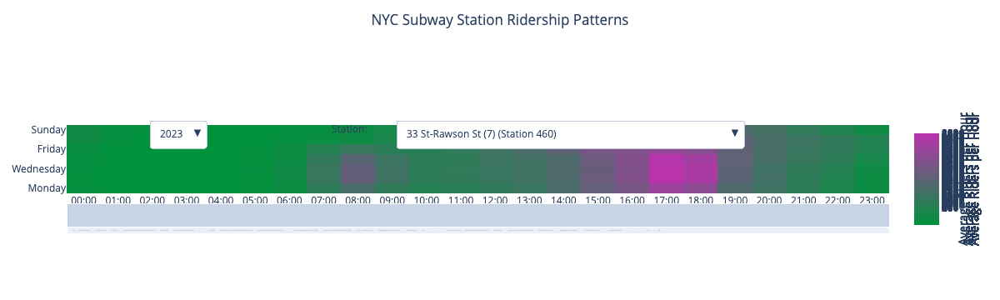

In [149]:
fig = create_station_heatmap(clean_22, clean_23, station_df)
fig.write_html('station_heatmap.html')
fig